<a href="https://colab.research.google.com/github/mariacornejor/TFGMICR/blob/main/CCTFG_code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Trabajo Fin de Grado**

**Autora:** María Isabel Cornejo Rojas

**Link video:** https://drive.google.com/file/d/1bwKACTlMneLS4yGfuC_czn0eiDNjln6k/view?usp=sharing





# Instalaciones

In [ ]:
!pip install --upgrade scikit-learn
!pip install --upgrade keras-tuner
!pip install --upgrade tensorflow
!pip install --upgrade keras
!pip install --upgrade scikeras
!pip install --upgrade lime
!pip install --upgrade shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 47.8 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 65.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 76.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 64.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 49.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 29.2 MB/s eta 0:00:00
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.2.0
    Uninstalling ml-dtypes-0.2.0:
      Successfully uninstalled ml-dtypes-0.2.0
  Attempting uni

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 1.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=fcce0db80141278de000502d0ef8fcd2a841847672c866d57649f41a19073906
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.5/540.5 kB 3.6 MB/s eta 0:00:00


# Librerías

In [ ]:
import random
import requests
import gdown
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn as sk
import tensorflow as tf
import keras
import kerastuner as kt
import shap
import lime
from IPython.display import display
from scipy.stats import uniform, loguniform, randint
from numpy import zeros, ones
from pandas import read_csv

# Lime
from lime.lime_tabular import LimeTabularExplainer
from lime.lime_text import LimeTextExplainer

# Concurrent and Parallel
from concurrent.futures import ThreadPoolExecutor, as_completed
from joblib import Parallel, delayed

# SKLearn metrics and utilities
from sklearn.preprocessing import (
    LabelEncoder, MinMaxScaler, OneHotEncoder, StandardScaler)
from sklearn.metrics import (
    precision_score, recall_score, f1_score, roc_auc_score,
    mean_absolute_percentage_error, accuracy_score, confusion_matrix,
    r2_score, classification_report, make_scorer
)
from sklearn.model_selection import (
    train_test_split, GridSearchCV, RandomizedSearchCV, cross_val_predict,
    cross_val_score, StratifiedKFold
)
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, SVR
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.feature_selection import SelectFromModel
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.neural_network import MLPClassifier

# TensorFlow and Keras
from tensorflow import keras
from keras import backend as K
from keras import regularizers, layers
from keras.callbacks import EarlyStopping
from keras.optimizers import Adam
from keras.activations import tanh
from keras.models import Sequential
from keras.layers import (
    Input, Embedding, Flatten, Dense, Concatenate, Dropout, BatchNormalization,
    LeakyReLU, Reshape, SimpleRNN, LSTM, GRU)
from keras.regularizers import l2
from keras.preprocessing.sequence import pad_sequences

# Keras Tuner
from kerastuner.tuners import RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters

<ipython-input-1-d6c4be2c3a99>:11: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  import kerastuner as kt


# Dataset

## Importe de dataset

In [ ]:
file_url = "https://drive.google.com/uc?id=1PsEVs-bolBZ68ceaLNvhyy0ZBAGHyD0J"

output_file = "dataset.csv"

gdown.download(file_url, output_file, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1PsEVs-bolBZ68ceaLNvhyy0ZBAGHyD0J
To: /content/dataset.csv
100%|██████████| 10.4k/10.4k [00:00<00:00, 9.31MB/s]


'dataset.csv'

## Lectura de dataset

In [ ]:
dataset = read_csv('dataset.csv', sep=',', decimal='.')

print(dataset.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 213 entries, 0 to 212
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   S/N               213 non-null    int64  
 1   Year              212 non-null    float64
 2   Age               213 non-null    int64  
 3   Menopause         213 non-null    int64  
 4   Tumor Size (cm)   212 non-null    float64
 5   Inv-Nodes         212 non-null    float64
 6   Breast            207 non-null    object 
 7   Metastasis        212 non-null    float64
 8   Breast Quadrant   211 non-null    object 
 9   History           211 non-null    float64
 10  Diagnosis Result  213 non-null    object 
dtypes: float64(5), int64(3), object(3)
memory usage: 18.4+ KB
None


In [ ]:
dataset

,S/N,Year,Age,Menopause,Tumor Size (cm),Inv-Nodes,Breast,Metastasis,Breast Quadrant,History,Diagnosis Result
0,1,2019.0,40,1,2.0,0.0,Right,0.0,Upper inner,0.0,Benign
1,2,2019.0,39,1,2.0,0.0,Left,0.0,Upper outer,0.0,Benign
2,3,2019.0,45,0,4.0,0.0,Left,0.0,Lower outer,0.0,Benign
3,4,2019.0,26,1,3.0,0.0,Left,0.0,Lower inner,1.0,Benign
4,5,2019.0,21,1,1.0,0.0,Right,0.0,Upper outer,1.0,Benign
...,...,...,...,...,...,...,...,...,...,...,...
208,209,2020.0,49,1,6.0,3.0,Right,1.0,Lower inner,1.0,Malignant
209,210,2020.0,28,1,3.0,0.0,Left,0.0,Upper inner,0.0,Benign
210,211,2020.0,22,1,1.0,0.0,Left,0.0,Upper outer,1.0,Benign
211,212,2020.0,19,1,1.0,0.0,Left,0.0,Lower inner,1.0,Benign


# EDA Pre-GAN

## Pre-procesamiento de data

### Limpieza

In [ ]:
# Reemplazar '#' con un valor nulo (NaN) en todo el DataFrame
dataset_cleaned = dataset.replace('#', np.nan)

# Eliminar filas con NaN
dataset_cleaned = dataset_cleaned.dropna()

# Eliminar la columna 'S/N'
dataset_cleaned = dataset_cleaned.drop('S/N', axis=1)

print("Tamaño del DataFrame después de eliminar filas con NaN:", dataset_cleaned.shape)

data = dataset_cleaned

Tamaño del DataFrame después de eliminar filas con NaN: (205, 10)


## Análisis variables númericas

In [ ]:
numeric_attributes = ['Age', 'Tumor Size (cm)', 'Inv-Nodes']

### Histrogramas

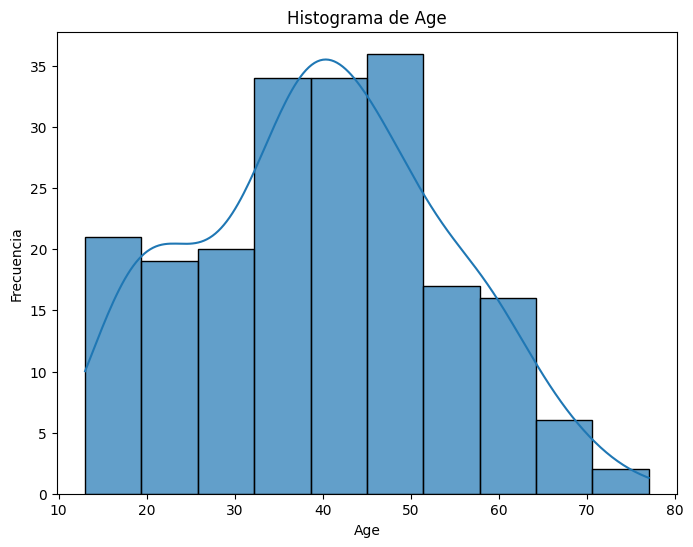

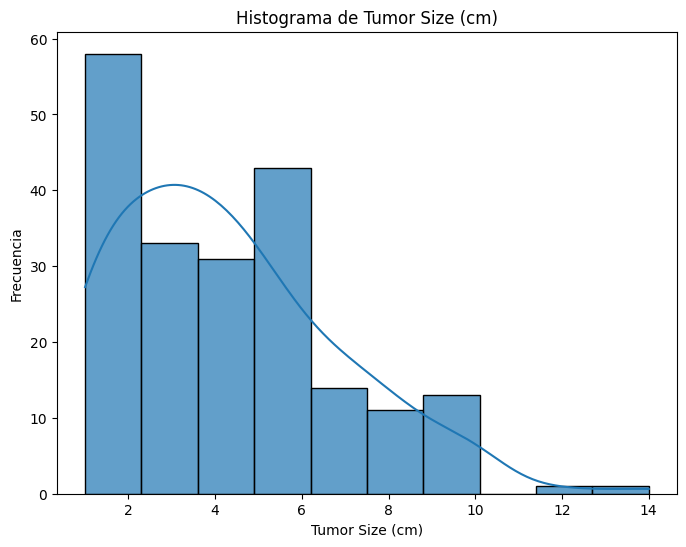

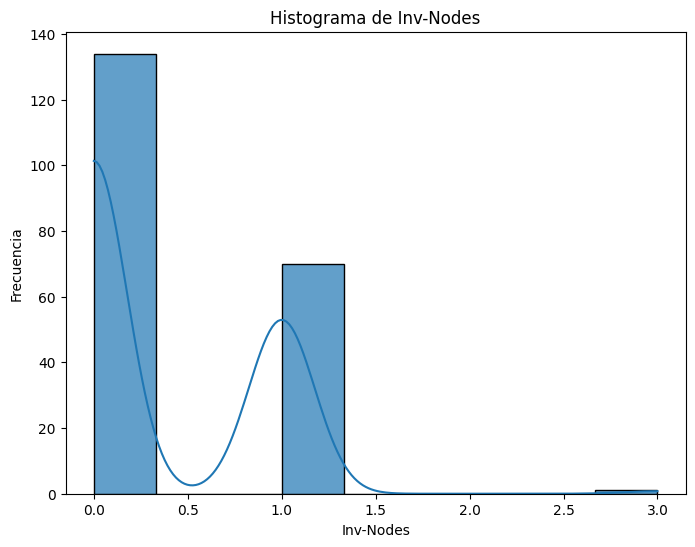

In [ ]:
for attribute in numeric_attributes:
    plt.figure(figsize=(8, 6))
    sns.histplot(data[attribute], kde=True, alpha=0.7)
    plt.title(f'Histograma de {attribute}')
    plt.xlabel(attribute)
    plt.ylabel('Frecuencia')
    plt.show()

1. **Histograma de Age**
*   Descripción: Este histograma muestra la distribución de edades en un conjunto de datos. Las edades están representadas en el eje horizontal (Age), que varía de 10 a 80 años, mientras que la frecuencia de cada grupo de edad está en el eje vertical. La mayoría de los datos se concentran entre los 30 y los 50 años, mostrando un pico máximo en torno a los 40 años.

2. **Histograma de Tumor Size(cm)**
*   Descripción: Este histograma presenta la distribución del tamaño de tumores en centímetros. El tamaño de los tumores está representado en el eje horizontal, que varía de 0 a 14 cm, y la frecuencia de cada tamaño está en el eje vertical. La distribución muestra una mayor frecuencia en tamaños pequeños, con un pico inicial alrededor de 2 cm y otro pico notable cerca de 6 cm.

3. **Histograma de Inv-Nodos**
*    Descripción: Este gráfico ilustra la distribución de nodos invadidos (Inv-Nodes) en un conjunto de datos médicos. El eje horizontal muestra el número de nodos invadidos, variando de 0.0 a 3.0, y el eje vertical indica la frecuencia de cada categoría. Hay un pico muy alto para 0.0 nodos invadidos, seguido de una disminución y un pico menor en 1.0.








### Pairplot

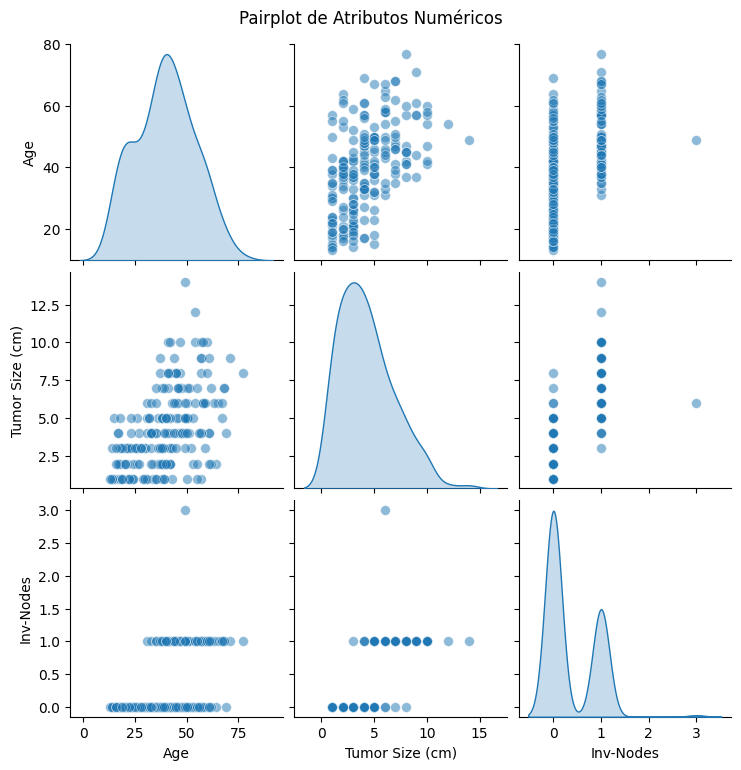

In [ ]:
sns.pairplot(data[numeric_attributes], diag_kind='kde', plot_kws={'alpha': 0.5, 's': 50})
plt.suptitle('Pairplot de Atributos Numéricos', y=1.02)
plt.show()

Este pairplot que muestra la relación entre tres variables numéricas: Age, Tumor Size (cm), y Inv-Nodes. Cada fila y columna representa una de las variables, creando una cuadrícula de gráficos. Los gráficos en la diagonal son histogramas que muestran la distribución de cada variable individualmente, mientras que los otros gráficos son diagramas de dispersión que muestran las correlaciones entre dos variables.



**Distribuciones individuales:**
- Age: Histograma con una distribución que muestra un pico alrededor de los 40-60 años.
- Tumor Size: Histograma con una distribución que tiene un pico en tamaños menores, alrededor de 2-5 cm.
- Inv-Nodes: Histograma que muestra una alta frecuencia en valores cercanos a cero y decrece rápidamente a medida que aumenta el número de nodos invadidos.

**Correlaciones:**
- Age vs. Tumor Size: Diagrama de dispersión sin una correlación clara, mostrando puntos ampliamente distribuidos.
- Age vs. Inv-Nodes: Diagrama de dispersión que muestra una mayoría de puntos agrupados cerca del origen, indicando pocos nodos invadidos independientemente de la edad.
- Tumor Size vs. Inv-Nodes: Similar al anterior, con muchos datos agrupados cerca del origen, indicando pocos nodos invadidos para la mayoría de los tamaños de tumor.




### Gráfico de dispersión entre Tumor y Edad

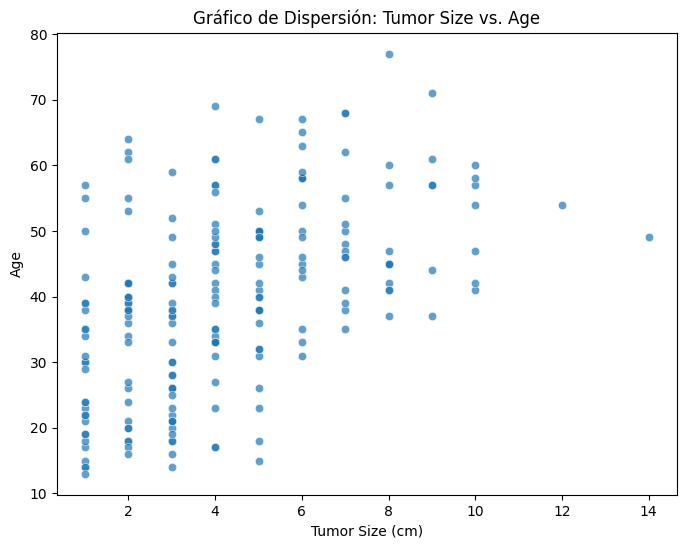

In [ ]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='Tumor Size (cm)', y='Age', data=data, alpha=0.7)
plt.title('Gráfico de Dispersión: Tumor Size vs. Age')
plt.xlabel('Tumor Size (cm)')
plt.ylabel('Age')
plt.show()

Este gráfico de dispersión muestra la relación entre el tamaño del tumor (en cm) y la edad (en años). El eje horizontal representa el tamaño del tumor, variando de 0 a 14 cm, mientras que el eje vertical muestra la edad, de 10 a 80 años.

**Observaciones:**
Los puntos están distribuidos sin una tendencia clara, indicando que no hay una relación fuerte entre la edad y el tamaño del tumor. La mayoría de los puntos están concentrados en tamaños de tumor pequeños (2-6 cm) y una amplia gama de edades.

## Análisis variables categóricas

In [ ]:
categorical_attributes = ['Breast', 'Breast Quadrant', 'Diagnosis Result']

In [ ]:
data['Breast Quadrant'] = data['Breast Quadrant'].str.strip()

data.dropna(subset=['Breast Quadrant'], inplace=True)

for attribute in categorical_attributes:
    print(f"Valores únicos en la columna '{attribute}':")
    print(data[attribute].unique())
    print()

Valores únicos en la columna 'Breast':
['Right' 'Left']

Valores únicos en la columna 'Breast Quadrant':
['Upper inner' 'Upper outer' 'Lower outer' 'Lower inner']

Valores únicos en la columna 'Diagnosis Result':
['Benign' 'Malignant']



### Gráficos

<ipython-input-12-4be93c54ddb3>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=dataset, x='Breast', palette='pastel')


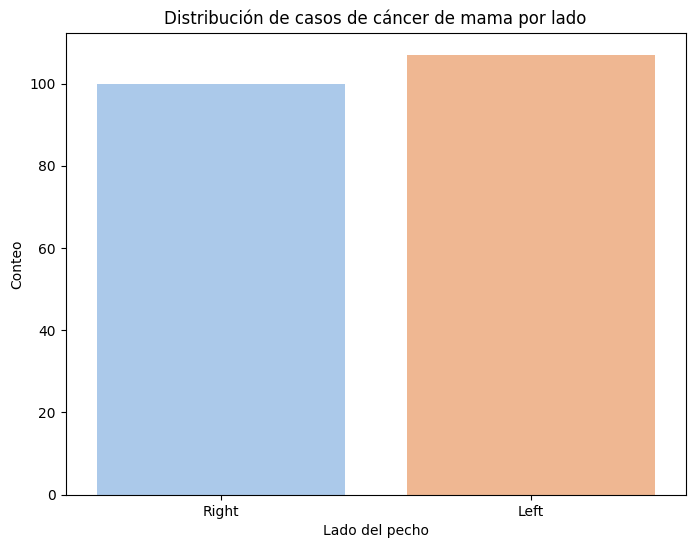

In [ ]:
plt.figure(figsize=(8, 6))
sns.countplot(data=dataset, x='Breast', palette='pastel')
plt.title('Distribución de casos de cáncer de mama por lado')
plt.xlabel('Lado del pecho')
plt.ylabel('Conteo')
plt.show()

El gráfico de barras muestra la distribución de casos de cáncer de mama en el lado derecho e izquierdo del pecho, con una cantidad similar de casos para ambos lados, indicando que no hay una diferencia significativa en la prevalencia de cáncer entre los dos lados.

<ipython-input-13-40ddf84f1a2a>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='Breast Quadrant', palette='pastel', order=data['Breast Quadrant'].value_counts().index)


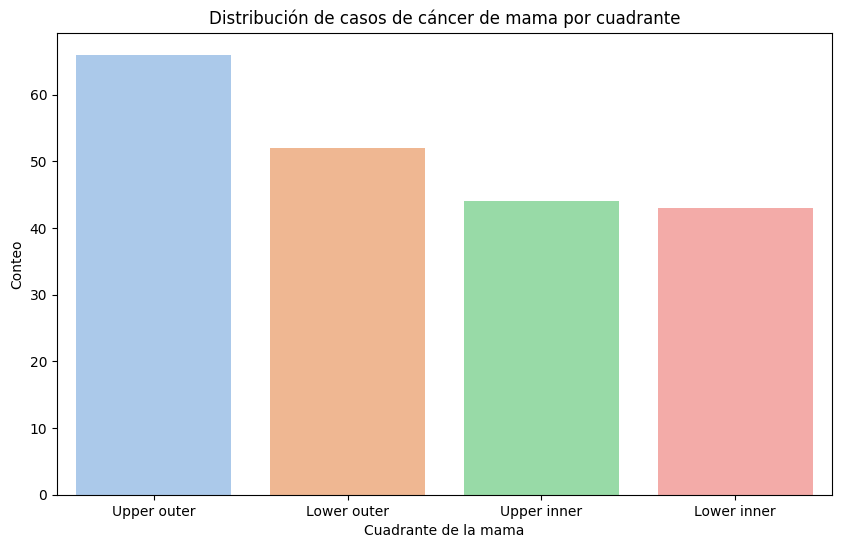

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(data=data, x='Breast Quadrant', palette='pastel', order=data['Breast Quadrant'].value_counts().index)
plt.title('Distribución de casos de cáncer de mama por cuadrante')
plt.xlabel('Cuadrante de la mama')
plt.ylabel('Conteo')
plt.show()

Es un gráfico de barras que muestra el conteo de casos de cáncer de mama distribuidos por cuadrantes del pecho: "Upper inner", "Upper outer", "Lower outer", y "Lower inner". El cuadrante "Upper outer" presenta el mayor número de casos.

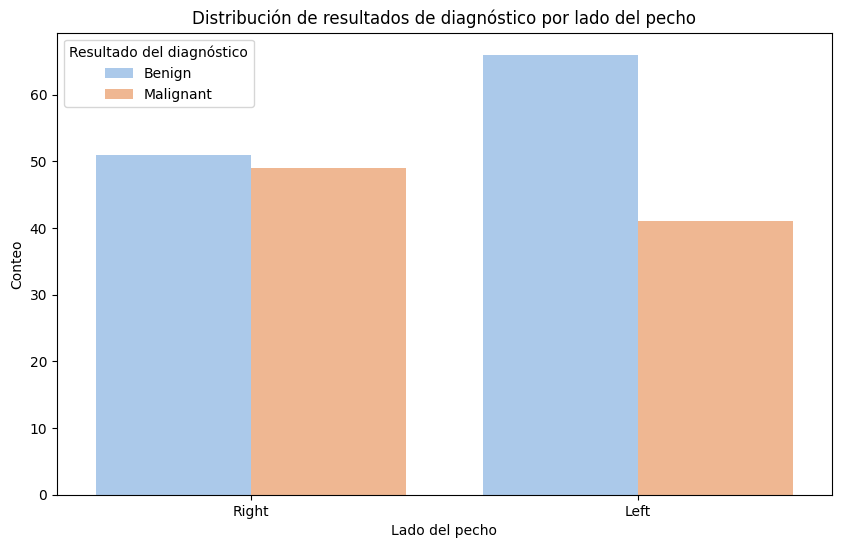

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(data=dataset, x='Breast', hue='Diagnosis Result', palette='pastel')
plt.title('Distribución de resultados de diagnóstico por lado del pecho')
plt.xlabel('Lado del pecho')
plt.ylabel('Conteo')
plt.legend(title='Resultado del diagnóstico')
plt.show()

Compara los resultados benignos y malignos de diagnósticos de cáncer de mama, separados por el lado derecho e izquierdo del pecho. Los casos malignos son predominantemente mayores en ambos lados.

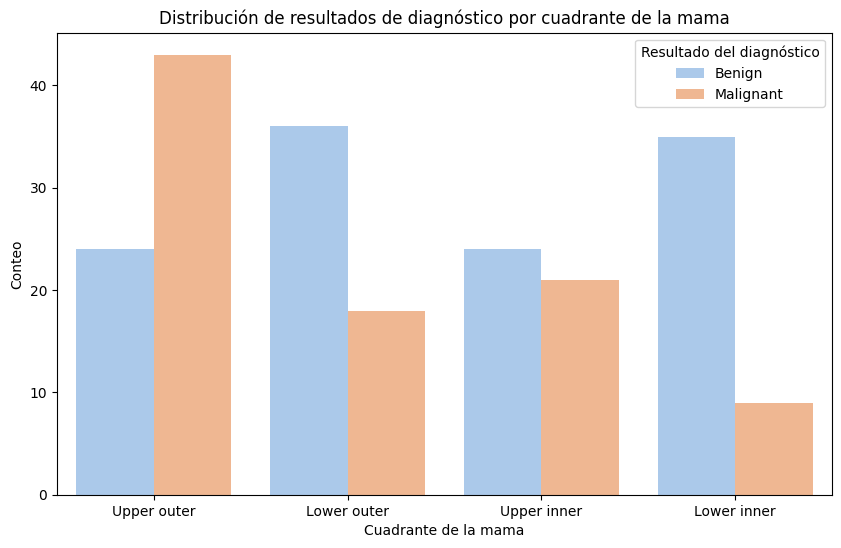

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(data=dataset, x='Breast Quadrant', hue='Diagnosis Result', palette='pastel', order=data['Breast Quadrant'].value_counts().index)
plt.title('Distribución de resultados de diagnóstico por cuadrante de la mama')
plt.xlabel('Cuadrante de la mama')
plt.ylabel('Conteo')
plt.legend(title='Resultado del diagnóstico')
plt.show()

Muestra los resultados benignos y malignos por cada cuadrante del pecho. El cuadrante "Upper outer" tiene la mayor incidencia de casos malignos.

<ipython-input-16-63c27a6b8fcf>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=dataset, x='Diagnosis Result', palette='pastel')


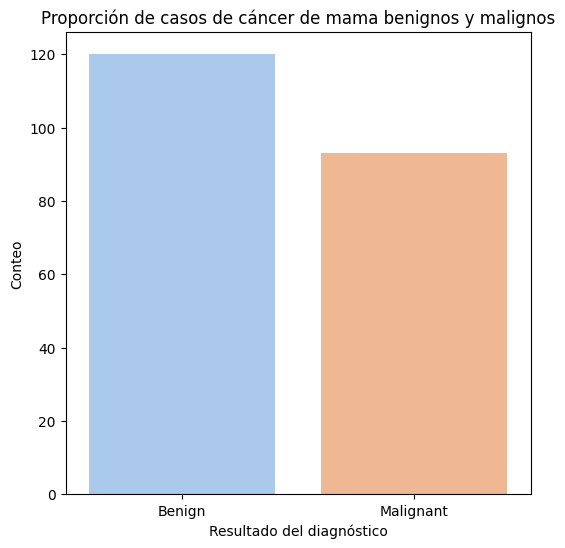

In [ ]:
plt.figure(figsize=(6, 6))
sns.countplot(data=dataset, x='Diagnosis Result', palette='pastel')
plt.title('Proporción de casos de cáncer de mama benignos y malignos')
plt.xlabel('Resultado del diagnóstico')
plt.ylabel('Conteo')
plt.show()

Gráfico de barras que compara el total de casos benignos frente a los malignos, mostrando un mayor número de casos benignos.

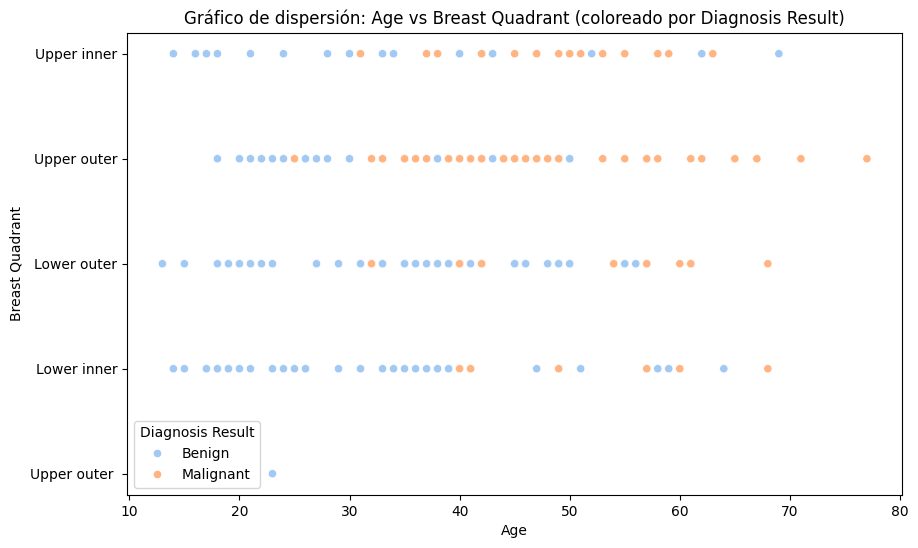

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=dataset, x='Age', y='Breast Quadrant', hue='Diagnosis Result', palette='pastel')
plt.title('Gráfico de dispersión: Age vs Breast Quadrant (coloreado por Diagnosis Result)')
plt.xlabel('Age')
plt.ylabel('Breast Quadrant')
plt.legend(title='Diagnosis Result')
plt.show()

Gráfico de dispersión que relaciona la edad con el cuadrante del pecho afectado, coloreado para diferenciar entre diagnósticos benignos y malignos. Se observa una distribución variada de casos a través de los cuadrantes y edades.

## Label Encoder

In [ ]:
label_encoder = LabelEncoder()
binary_categoricals = ['Menopause', 'Breast', 'Metastasis', 'History', 'Diagnosis Result']
for col in binary_categoricals:
    data[col] = label_encoder.fit_transform(data[col])

## One-Hot Encoding

In [ ]:
onehot_encoder = OneHotEncoder()

# Aplicar OneHotEncoder a las variables con más de dos categorías
categoricals_to_encode = ['Breast Quadrant', 'Inv-Nodes']
encoded_features = pd.DataFrame()

for col in categoricals_to_encode:
    encoded_data = pd.get_dummies(data[col], prefix=col)
    encoded_features = pd.concat([encoded_features, encoded_data], axis=1)

## Concatenar variables codificadas

In [ ]:
# Concatenar las nuevas variables codificadas con el conjunto de datos original
dataset_encoded = pd.concat([data, encoded_features], axis=1)

# Eliminar las columnas originales categóricas
dataset_encoded.drop(categoricals_to_encode, axis=1, inplace=True)

## Exportación de dataset limpio

In [ ]:
dataset_encoded = dataset_encoded.drop('Inv-Nodes_3.0', axis=1)

In [ ]:
dataset_encoded #Este será nuestro dataset nuevo

,Year,Age,Menopause,Tumor Size (cm),Breast,Metastasis,History,Diagnosis Result,Breast Quadrant_Lower inner,Breast Quadrant_Lower outer,Breast Quadrant_Upper inner,Breast Quadrant_Upper outer,Inv-Nodes_0.0,Inv-Nodes_1.0
0,2019.0,40,1,2.0,1,0,0,0,False,False,True,False,True,False
1,2019.0,39,1,2.0,0,0,0,0,False,False,False,True,True,False
2,2019.0,45,0,4.0,0,0,0,0,False,True,False,False,True,False
3,2019.0,26,1,3.0,0,0,1,0,True,False,False,False,True,False
4,2019.0,21,1,1.0,1,0,1,0,False,False,False,True,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
208,2020.0,49,1,6.0,1,1,1,1,True,False,False,False,False,False
209,2020.0,28,1,3.0,0,0,0,0,False,False,True,False,True,False
210,2020.0,22,1,1.0,0,0,1,0,False,False,False,True,True,False
211,2020.0,19,1,1.0,0,0,1,0,True,False,False,False,True,False


# GAN

## Codificación de GAN

### División de datos

In [ ]:
# Utilizaremos dataset_encoded como datos
X_train, X_test = train_test_split(dataset_encoded, test_size=0.2, random_state=42)
print(dataset_encoded.info())

<class 'pandas.core.frame.DataFrame'>
Index: 205 entries, 0 to 212
Data columns (total 14 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Year                         205 non-null    float64
 1   Age                          205 non-null    int64  
 2   Menopause                    205 non-null    int64  
 3   Tumor Size (cm)              205 non-null    float64
 4   Breast                       205 non-null    int64  
 5   Metastasis                   205 non-null    int64  
 6   History                      205 non-null    int64  
 7   Diagnosis Result             205 non-null    int64  
 8   Breast Quadrant_Lower inner  205 non-null    bool   
 9   Breast Quadrant_Lower outer  205 non-null    bool   
 10  Breast Quadrant_Upper inner  205 non-null    bool   
 11  Breast Quadrant_Upper outer  205 non-null    bool   
 12  Inv-Nodes_0.0                205 non-null    bool   
 13  Inv-Nodes_1.0            

### Declaraciones

In [ ]:
n_batch = 64
n_epochs = 10000
latent_dim = 16

# Learning rate y beta para el optimizador Adam
learning_rate = 0.0002
beta_1 = 0.5

### Discriminador

In [ ]:
def define_discriminator(n_features):
    model = Sequential()
    model.add(Dense(128, input_dim=n_features))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=learning_rate, beta_1=beta_1), metrics=['accuracy'])
    return model

### Generador

In [ ]:
def define_generator(latent_dim, n_outputs):
    model = Sequential()
    model.add(Dense(128, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Dense(n_outputs, activation='tanh'))
    return model

In [ ]:
# Obtener el número de características
n_features = dataset_encoded.shape[1]

# Crear el discriminador
discriminator = define_discriminator(n_features)

# Crear el generador
generator = define_generator(latent_dim, n_features)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


### Definción de GAN

In [ ]:
def define_gan(generator, discriminator):
    discriminator.trainable = False
    model = Sequential([generator, discriminator])
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=learning_rate, beta_1=beta_1))
    return model

# Crear la GAN
gan_model = define_gan(generator, discriminator)

### Funciones

In [ ]:
def generate_real_samples(dataset_encoded, n_samples):
    indices = np.random.randint(0, dataset_encoded.shape[0], n_samples)
    X = dataset_encoded[indices]
    y = np.ones((n_samples, 1))
    return X, y

def generate_latent_points(latent_dim, n_samples):
    x_input = np.random.randn(latent_dim * n_samples)
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input

def generate_fake_samples(generator, latent_dim, n_samples):
    x_input = generate_latent_points(latent_dim, n_samples)
    X = generator.predict(x_input)
    y = np.zeros((n_samples, 1))
    return X, y

In [ ]:
def train_discriminator(discriminator, dataset_encoded, latent_dim, n_epochs=10000, n_batch=64):
    half_batch = int(n_batch / 2)
    for epoch in range(n_epochs):
        X_real, y_real = generate_real_samples(dataset_encoded, half_batch)
        d_loss_real = discriminator.train_on_batch(X_real, y_real)

        X_fake, y_fake = generate_fake_samples(generator, latent_dim, half_batch)
        d_loss_fake = discriminator.train_on_batch(X_fake, y_fake)

        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        print(f'Epoch {epoch}/{n_epochs}, D Loss: {d_loss[0]}')

## Entrenamiento de GAN

In [ ]:
def train_gan(gan_model, generator, discriminator, latent_dim, dataset_encoded, n_epochs=10000, n_batch=64):
    for epoch in range(n_epochs):
        x_gan = generate_latent_points(latent_dim, n_batch)
        y_gan = np.ones((n_batch, 1))
        g_loss = gan_model.train_on_batch(x_gan, y_gan)

        print(f'Epoch {epoch}/{n_epochs}, G Loss: {g_loss}')

In [ ]:
# Escalar los datos
scaler = MinMaxScaler(feature_range=(-1, 1))
dataset_scaled = scaler.fit_transform(dataset_encoded)

In [ ]:
d_loss_list = []
g_loss_list = []

for current_epoch in range(n_epochs):
    X_real, y_real = generate_real_samples(dataset_scaled, n_batch)
    d_loss_real = discriminator.train_on_batch(X_real, y_real)

    X_fake, y_fake = generate_fake_samples(generator, latent_dim, n_batch)
    d_loss_fake = discriminator.train_on_batch(X_fake, y_fake)

    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

    x_gan = generate_latent_points(latent_dim, n_batch)
    y_gan = np.ones((n_batch, 1))
    g_loss = gan_model.train_on_batch(x_gan, y_gan)

    if current_epoch % 1000 == 0:
        d_loss_list.append(d_loss)
        g_loss_list.append(g_loss)
        print(f'Epoch {current_epoch}/{n_epochs}, D Loss: {d_loss[0]}, G Loss: {g_loss}')

print("Entrenamiento completado. Resumen final:")
print(f'Final D Loss: {d_loss[0]}, Final G Loss: {g_loss}')


# Visualizar pérdidas a lo largo del tiempo
plt.plot(d_loss_list, label='Discriminator Loss')
plt.plot(g_loss_list, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/trainer.py:71: UserWarning: The model does not have any trainable weights.
  warnings.warn("The model does not have any trainable weights.")


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step  
Epoch 0/10000, D Loss: 0.6124169826507568, G Loss: [array(0.6611778, dtype=float32), array(0.6611778, dtype=float32), array(0.53125, dtype=float32)]
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━

## Generación de nuevo dataset

In [ ]:
# Generar muestras sintéticas
def generate_synthetic_samples(generator, latent_dim, n_samples):
    x_input = generate_latent_points(latent_dim, n_samples)
    X = generator.predict(x_input)
    return X

# Número de muestras sintéticas a generar
n_synthetic_samples = 10000

synthetic_samples = generate_synthetic_samples(generator, latent_dim, n_synthetic_samples)

# Visualizar las muestras sintéticas
print("Muestras Sintéticas Generadas:")
print(synthetic_samples)

In [ ]:
inverse_transformed_data = scaler.inverse_transform(synthetic_samples)
inverse_transformed_data = np.round(inverse_transformed_data)
print(inverse_transformed_data)

## Exportación de dataset

In [ ]:
drive.mount('/content/drive')

In [ ]:
generated_dataset = pd.DataFrame(inverse_transformed_data, columns=X_train.columns)

drive_csv_path = '/content/drive/My Drive/TFG/Oficial/datasetPostGAN.csv'

generated_dataset.to_csv(drive_csv_path, index=False)

print(f'Datos generados guardados en {drive_csv_path}')

# EDA Post-GAN

## Lectura de nuevo dataset

In [ ]:
file_url = "https://drive.google.com/uc?id=1r1XzhKy5msFVYnwOMC3DfVprJBPbVj0N"

output_file = "dataset.csv"

gdown.download(file_url, output_file, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1r1XzhKy5msFVYnwOMC3DfVprJBPbVj0N
To: /content/dataset.csv
100%|██████████| 681k/681k [00:00<00:00, 9.02MB/s]


'dataset.csv'

In [ ]:
# Leemos el dataset
datasetGAN = read_csv('dataset.csv', sep=',', decimal='.')

datasetGAN = datasetGAN.drop('Inv-Nodes_3.0', axis=1)

datasetGAN.to_csv('dataset_modificado.csv', index=False)

In [ ]:
datasetGAN.drop(columns=['Breast Quadrant_Upper outer', 'Year'], inplace=True)

In [ ]:
print(datasetGAN.columns)

Index(['Age', 'Menopause', 'Tumor Size (cm)', 'Breast', 'Metastasis',
       'History', 'Diagnosis Result', 'Breast Quadrant_Lower inner',
       'Breast Quadrant_Lower outer', 'Breast Quadrant_Upper inner',
       'Breast Quadrant_Upper outer ', 'Inv-Nodes_0.0', 'Inv-Nodes_1.0'],
      dtype='object')


## Análisis de variables

In [ ]:
# Imprimimos la información del dataset
print(datasetGAN.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Age                           10000 non-null  float64
 1   Menopause                     10000 non-null  float64
 2   Tumor Size (cm)               10000 non-null  float64
 3   Breast                        10000 non-null  float64
 4   Metastasis                    10000 non-null  float64
 5   History                       10000 non-null  float64
 6   Diagnosis Result              10000 non-null  float64
 7   Breast Quadrant_Lower inner   10000 non-null  float64
 8   Breast Quadrant_Lower outer   10000 non-null  float64
 9   Breast Quadrant_Upper inner   10000 non-null  float64
 10  Breast Quadrant_Upper outer   10000 non-null  float64
 11  Inv-Nodes_0.0                 10000 non-null  float64
 12  Inv-Nodes_1.0                 10000 non-null  float64
dtypes:

In [ ]:
datasetGAN

,Age,Menopause,Tumor Size (cm),Breast,Metastasis,History,Diagnosis Result,Breast Quadrant_Lower inner,Breast Quadrant_Lower outer,Breast Quadrant_Upper inner,Breast Quadrant_Upper outer,Inv-Nodes_0.0,Inv-Nodes_1.0
0,46.0,1.0,5.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,34.0,1.0,3.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,51.0,1.0,9.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,20.0,1.0,2.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,23.0,1.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,27.0,1.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
9996,37.0,1.0,5.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
9997,37.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
9998,41.0,0.0,5.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0


### Mapa de correlación


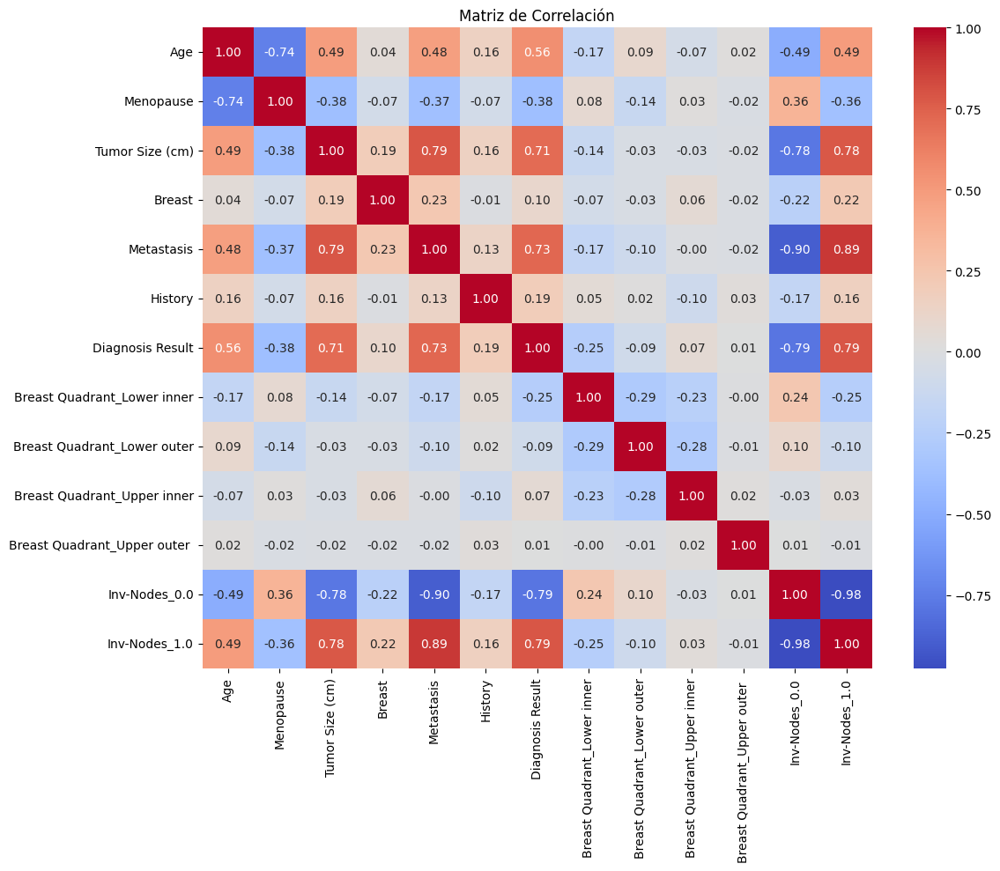

In [ ]:
plt.figure(figsize=(12, 10))
corr_matrix = datasetGAN.corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlación')
plt.tight_layout()
plt.show()

Esta matriz de correlación muestra las relaciones estadísticas entre diferentes variables clínicas relacionadas con el cáncer de mama. Cada celda de la matriz representa el coeficiente de correlación entre dos variables, variando de -1.00 a 1.00, donde 1.00 indica una correlación perfecta positiva, -1.00 una correlación perfecta negativa, y 0 indica que no hay correlación.

**Descripción de algunas correlaciones destacadas:**
- Edad y Menopausia: Correlación fuerte y negativa (-0.74), lo que sugiere que las mujeres más jóvenes tienden a no estar en menopausia.
- Tamaño del Tumor y Metástasis: Correlación positiva significativa (0.79), indicando que tumores más grandes pueden estar asociados con un mayor riesgo de metástasis.
- Resultado del Diagnóstico y Varios Factores: Hay fuertes correlaciones positivas con el tamaño del tumor (0.71), metástasis (0.73), y otros, lo que sugiere que estos factores son indicativos de resultados de diagnóstico más graves.
- Inv-Nodes_0 e Inv-Nodes_1: Correlación negativa casi perfecta (-0.98), indicando una fuerte relación inversa entre estas categorías de nodos involucrados.

**Colores en la Matriz:**
- Las celdas están coloreadas de rojo a azul, donde el rojo indica una fuerte correlación positiva y el azul una fuerte correlación negativa.

### Gráficos de Barras

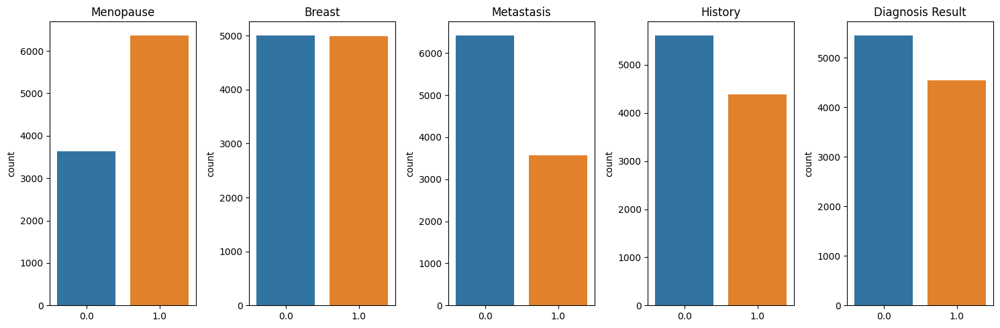

In [ ]:
cat_cols = ['Menopause', 'Breast', 'Metastasis', 'History', 'Diagnosis Result']
fig, axes = plt.subplots(nrows=1, ncols=len(cat_cols), figsize=(15, 5))
for i, col in enumerate(cat_cols):
    sns.countplot(x=col, data=datasetGAN, hue=col, ax=axes[i], legend=False)
    axes[i].set_title(col)
    axes[i].set_xlabel('')
plt.tight_layout()
plt.show()

- Menopausia: Compara la cantidad de casos premenopáusicos (0.0) y posmenopáusicos (1.0), con más casos posmenopáusicos.
- Lado del Pecho Afectado (Breast): Muestra una distribución casi igual entre los lados derecho (0.0) e izquierdo (1.0) del pecho.
- Metástasis: Compara los casos sin metástasis (0.0) con aquellos que tienen metástasis (1.0), siendo los primeros más comunes.
- Historial Familiar (History): Muestra más casos sin historial familiar de cáncer de mama (0.0) en comparación con aquellos que sí tienen (1.0).
- Resultado del Diagnóstico: Compara los casos benignos (0.0) y malignos (1.0), siendo los benignos más comunes.

### Gráfico de Dispersión de atributo específico

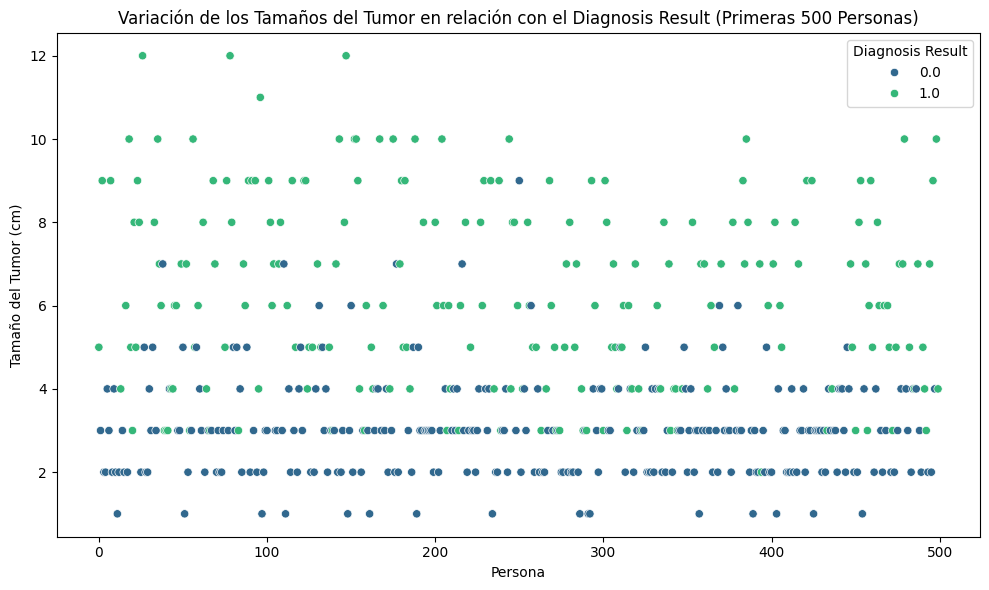

In [ ]:
# Definir 'subset' como las primeras 500 filas de tu conjunto de datos
subset = datasetGAN.iloc[:500]

plt.figure(figsize=(10, 6))
sns.scatterplot(x=subset.index, y='Tumor Size (cm)', hue='Diagnosis Result', data=subset, palette='viridis')
plt.title('Variación de los Tamaños del Tumor en relación con el Diagnosis Result (Primeras 500 Personas)')
plt.xlabel('Persona')
plt.ylabel('Tamaño del Tumor (cm)')
plt.legend(title='Diagnosis Result')
plt.tight_layout()
plt.show()

Presenta el tamaño del tumor en centímetros para las primeras 500 personas, coloreado por resultado del diagnóstico (benigno o maligno). La distribución de los tamaños del tumor varía ampliamente entre los pacientes, con una mezcla de resultados benignos y malignos a lo largo de diferentes tamaños de tumor.


# Comparación variables dataset original y sintético

float64


<ipython-input-34-5be7a05a2547>:2: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(dataset_encoded['Age'], label='Original', shade=True)
<ipython-input-34-5be7a05a2547>:3: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(datasetGAN['Age'], label='Generado', shade=True)


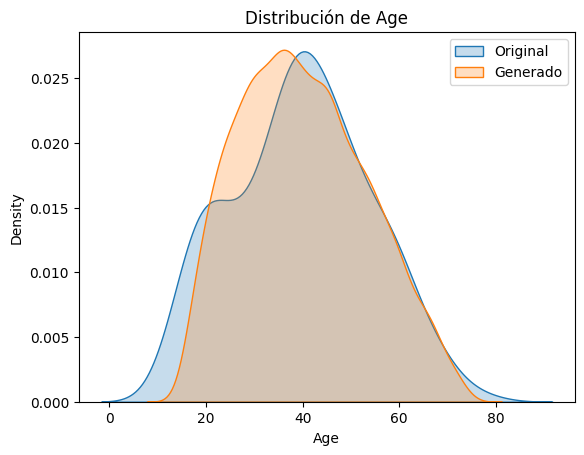

In [ ]:
print(datasetGAN['Age'].dtype)
sns.kdeplot(dataset_encoded['Age'], label='Original', shade=True)
sns.kdeplot(datasetGAN['Age'], label='Generado', shade=True)
plt.title('Distribución de Age')
plt.legend()
plt.show()

El gráfico muestra dos curvas de densidad que representan la distribución de la edad. La curva azul representa la distribución original de los datos, mientras que la naranja representa la distribución de datos generados.

**Observaciones:** Las curvas indican que los datos generados tienen una distribución más amplia y menos picuda en comparación con los datos originales, que muestran un pico más definido alrededor de los 60 años.

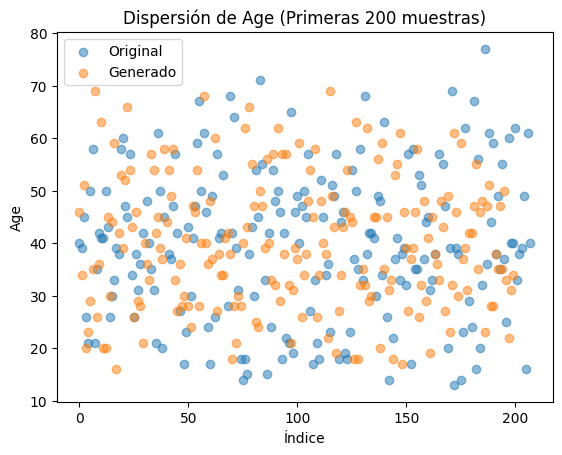

In [ ]:
variable_to_compare = 'Age'

# Seleccionar solo 200 muestras del dataset original
subset_original = dataset_encoded.head(200)

# Seleccionar solo 200 muestras del dataset generado
subset_generated = datasetGAN.head(200)

# Gráfico de dispersión para la variable en el dataset original
plt.scatter(subset_original.index, subset_original[variable_to_compare], label='Original', alpha=0.5)

# Gráfico de dispersión para la misma variable en el dataset generado
plt.scatter(subset_generated.index, subset_generated[variable_to_compare], label='Generado', alpha=0.5)

plt.title(f'Dispersión de {variable_to_compare} (Primeras 200 muestras)')
plt.xlabel('Índice')
plt.ylabel(variable_to_compare)
plt.legend()
plt.show()

Este gráfico de dispersión muestra la edad de las primeras 200 muestras, diferenciando entre los datos originales (en azul) y los generados (en naranja).

**Observaciones:** Los puntos están mezclados, lo que indica que los datos generados reflejan de forma razonable la dispersión de los datos originales, aunque con ciertas diferencias en la distribución de las edades.

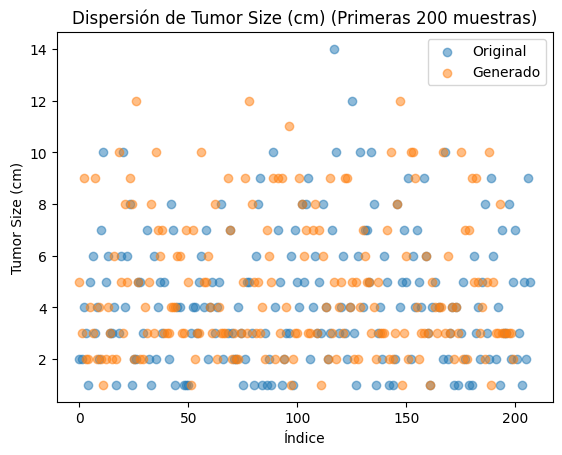

In [ ]:
variable_to_compare = 'Tumor Size (cm)'

# Seleccionar solo 200 muestras del dataset original
subset_original = dataset_encoded.head(200)

# Seleccionar solo 200 muestras del dataset generado
subset_generated = datasetGAN.head(200)

# Gráfico de dispersión para la variable en el dataset original
plt.scatter(subset_original.index, subset_original[variable_to_compare], label='Original', alpha=0.5)

# Gráfico de dispersión para la misma variable en el dataset generado
plt.scatter(subset_generated.index, subset_generated[variable_to_compare], label='Generado', alpha=0.5)

plt.title(f'Dispersión de {variable_to_compare} (Primeras 200 muestras)')
plt.xlabel('Índice')
plt.ylabel(variable_to_compare)
plt.legend()
plt.show()

Este gráfico muestra la dispersión del tamaño del tumor en centímetros para las primeras 200 muestras, diferenciando entre los datos originales (azul) y los generados (naranja).

**Observaciones:** Los puntos indican que el tamaño del tumor generado tiene una distribución comparable a la de los datos originales, aunque con algunas variaciones en los valores extremos.

# Aplicación de Inteligencia Artificial

## Prepración dataset

### Separación de features y target

In [ ]:
X = datasetGAN.drop(['Diagnosis Result'], axis=1)  # Características
y = datasetGAN['Diagnosis Result']  # Target

# Verificando las dimensiones de X e y
print("Dimensiones de X (Features):", X.shape)
print("\nDimensiones de y (Target):", y.shape)

Dimensiones de X (Features): (10000, 12)

Dimensiones de y (Target): (10000,)


### Separación de train, validation y test

In [ ]:
train_ratio = 0.60
validation_ratio = 0.20
test_ratio = 0.20

X_train, X_test, y_train, y_test = train_test_split(
    X,
    y,
    test_size=1 - train_ratio,
    shuffle=True,
    random_state=1)

X_val, X_test, y_val, y_test = train_test_split(
    X_test,
    y_test,
    test_size=test_ratio/(test_ratio + validation_ratio),
    shuffle=True,
    random_state=1)

print('Train - Features:')
print(X_train.shape)

print('Train - Target:')
print(y_train.shape)

print('\n\nValidation - Features:')
print(X_val.shape)

print('Validation - Target:')
print(y_val.shape)

print('\n\nTest - Features:')
print(X_test.shape)

print('Test - Target:')
print(y_test.shape)

Train - Features:
(6000, 12)
Train - Target:
(6000,)


Validation - Features:
(2000, 12)
Validation - Target:
(2000,)


Test - Features:
(2000, 12)
Test - Target:
(2000,)


In [ ]:
n_samples, n_features = X_train.shape
print("Número de muestras:", n_samples)
print("Número de características:", n_features)

# Mostrar los nombres reales de las características
feature_names = X.columns.tolist()
print("Nombres de características:", feature_names)

Número de muestras: 6000
Número de características: 12
Nombres de características: ['Age', 'Menopause', 'Tumor Size (cm)', 'Breast', 'Metastasis', 'History', 'Breast Quadrant_Lower inner', 'Breast Quadrant_Lower outer', 'Breast Quadrant_Upper inner', 'Breast Quadrant_Upper outer ', 'Inv-Nodes_0.0', 'Inv-Nodes_1.0']


### Normalización

In [ ]:
# Normalizar los datos
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Dividir los datos en conjuntos de entrenamiento, validación y prueba
X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y, train_size=0.6, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, train_size=0.5, random_state=42)

# Los datos ya están normalizados, no es necesario volver a normalizarlos
X_train_normalized = X_train
X_val_normalized = X_val
X_test_normalized = X_test

# Guardar los datos en archivos .npy
np.save('X_train_normalized.npy', X_train_normalized)
np.save('y_train.npy', y_train)
np.save('X_val_normalized.npy', X_val_normalized)
np.save('y_val.npy', y_val)
np.save('X_test_normalized.npy', X_test_normalized)
np.save('y_test.npy', y_test)

# Verificación de los archivos guardados
print("Datos de entrenamiento guardados en 'X_train_normalized.npy' y 'y_train.npy'")
print("Datos de validación guardados en 'X_val_normalized.npy' y 'y_val.npy'")
print("Datos de prueba guardados en 'X_test_normalized.npy' y 'y_test.npy'")

Datos de entrenamiento guardados en 'X_train_normalized.npy' y 'y_train.npy'
Datos de validación guardados en 'X_val_normalized.npy' y 'y_val.npy'
Datos de prueba guardados en 'X_test_normalized.npy' y 'y_test.npy'


## Machine Learning (ML)

###  Métricas de evaluación ML

In [ ]:
def evaluar_ML(y_test, y_test_pred):
    precision = precision_score(y_test, y_test_pred)
    recall = recall_score(y_test, y_test_pred)
    f1 = f1_score(y_test, y_test_pred)
    auc_score = roc_auc_score(y_test, y_test_pred)

    return {'Precision': precision, 'Recall': recall, 'F1-Score': f1, 'AUC': auc_score}

### Regresión Logística

In [ ]:
# Define el modelo de Regresión Logística
logistic_regression = LogisticRegression(solver='lbfgs', random_state=1)

# Define la cuadrícula de hiperparámetros a explorar
param_grid_lr = {
    'C': [0.1, 1, 10, 100],
    'penalty': ['l2']
}

# Realiza la búsqueda de hiperparámetros utilizando GridSearchCV
grid_search_lr = GridSearchCV(estimator=logistic_regression, param_grid=param_grid_lr, cv=3, scoring='accuracy', verbose=2)
grid_search_lr.fit(X_train_normalized, y_train)

# Obtiene el mejor modelo encontrado
best_logistic_regression = grid_search_lr.best_estimator_

# Realiza predicciones en los datos normalizados de validación y prueba utilizando el mejor modelo
y_val_pred_lr = best_logistic_regression.predict(X_val_normalized)
y_test_pred_lr = best_logistic_regression.predict(X_test_normalized)

# Evalúa el rendimiento del mejor modelo en los datos de validación y prueba
metrics_val_lr = evaluar_ML(y_val, y_val_pred_lr)
metrics_test_lr = evaluar_ML(y_test, y_test_pred_lr)

Fitting 3 folds for each of 4 candidates, totalling 12 fits
[CV] END ..................................C=0.1, penalty=l2; total time=   0.1s
[CV] END ..................................C=0.1, penalty=l2; total time=   0.2s
[CV] END ..................................C=0.1, penalty=l2; total time=   0.1s
[CV] END ....................................C=1, penalty=l2; total time=   0.1s
[CV] END ....................................C=1, penalty=l2; total time=   0.1s
[CV] END ....................................C=1, penalty=l2; total time=   0.1s
[CV] END ...................................C=10, penalty=l2; total time=   0.1s
[CV] END ...................................C=10, penalty=l2; total time=   0.1s
[CV] END ...................................C=10, penalty=l2; total time=   0.0s
[CV] END ..................................C=100, penalty=l2; total time=   0.0s
[CV] END ..................................C=100, penalty=l2; total time=   0.0s
[CV] END ..................................C=100,

#### Evaluación

In [ ]:
print("Mejores hiperparámetros encontrados:", grid_search_lr.best_params_)
print("\nMétricas en datos de validación:")
print(metrics_val_lr)
print("\nMétricas en datos de prueba:")
print(metrics_test_lr)

Mejores hiperparámetros encontrados: {'C': 1, 'penalty': 'l2'}

Métricas en datos de validación:
{'Precision': 0.9272943980929678, 'Recall': 0.8712206047032475, 'F1-Score': 0.8983833718244804, 'AUC': 0.9080583601655352}

Métricas en datos de prueba:
{'Precision': 0.9396449704142011, 'Recall': 0.8668122270742358, 'F1-Score': 0.9017603634298694, 'AUC': 0.9098821282972656}


### Gradient Boosting

In [ ]:
# Define el modelo de Gradient Boosting
gradient_boosting = GradientBoostingClassifier(random_state=1)

# Define la cuadrícula de hiperparámetros a explorar
param_grid_gb = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7]
}

# Realiza la búsqueda de hiperparámetros utilizando GridSearchCV
grid_search_gb = GridSearchCV(estimator=gradient_boosting, param_grid=param_grid_gb, cv=3, scoring='accuracy', verbose=2)
grid_search_gb.fit(X_train_normalized, y_train)

# Obtiene el mejor modelo encontrado
best_gradient_boosting = grid_search_gb.best_estimator_

# Realiza predicciones en los datos normalizados de validación y prueba utilizando el mejor modelo
y_val_pred_gb = best_gradient_boosting.predict(X_val_normalized)
y_test_pred_gb = best_gradient_boosting.predict(X_test_normalized)

# Evalúa el rendimiento del mejor modelo en los datos de validación y prueba
metrics_val_gb = evaluar_ML(y_val, y_val_pred_gb)
metrics_test_gb = evaluar_ML(y_test, y_test_pred_gb)

Fitting 3 folds for each of 27 candidates, totalling 81 fits
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.3s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.3s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.3s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=200; total time=   0.6s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=200; total time=   0.6s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=200; total time=   0.6s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=300; total time=   0.9s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=300; total time=   0.9s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=300; total time=   1.2s
[CV] END ..learning_rate=0.01, max_depth=5, n_estimators=100; total time=   0.8s
[CV] END ..learning_rate=0.01, max_depth=5, n_estimators=100; total time=   0.8s
[CV] END ..learning_rate=0.01, max_depth=5, n_es

#### Evaluación

In [ ]:
print("Mejores hiperparámetros encontrados:", grid_search_gb.best_params_)
print("\nMétricas en datos de validación:")
print(metrics_val_gb)
print("\nMétricas en datos de prueba:")
print(metrics_test_gb)

Mejores hiperparámetros encontrados: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}

Métricas en datos de validación:
{'Precision': 0.926056338028169, 'Recall': 0.883538633818589, 'F1-Score': 0.904297994269341, 'AUC': 0.9133140323564489}

Métricas en datos de prueba:
{'Precision': 0.9305239179954442, 'Recall': 0.8919213973799127, 'F1-Score': 0.9108138238573021, 'AUC': 0.9178241673246428}


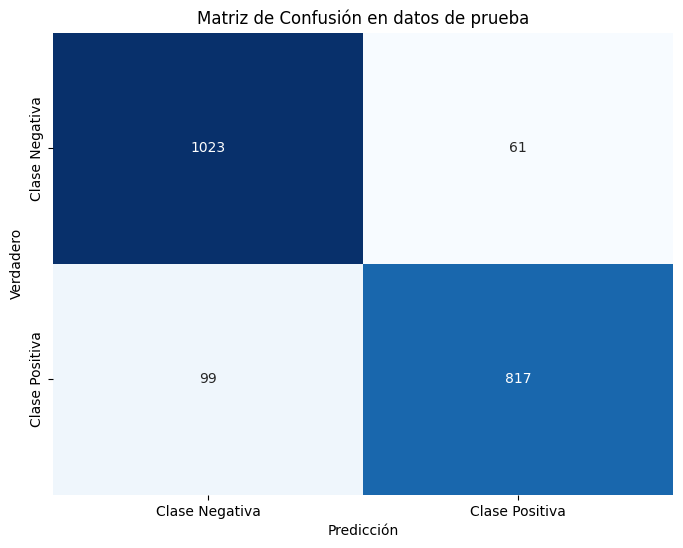

In [ ]:
# Obtener la matriz de confusión para los datos de prueba
conf_matrix_test = confusion_matrix(y_test, y_test_pred_gb)

# Visualizar la matriz de confusión utilizando seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_test, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=["Clase Negativa", "Clase Positiva"],
            yticklabels=["Clase Negativa", "Clase Positiva"])
plt.title("Matriz de Confusión en datos de prueba")
plt.xlabel("Predicción")
plt.ylabel("Verdadero")
plt.show()

### Random Forest

In [ ]:
# Define el modelo de Random Forest
random_forest = RandomForestClassifier(random_state=1)

# Define la cuadrícula de hiperparámetros a explorar
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Realiza la búsqueda de hiperparámetros utilizando GridSearchCV
grid_search = GridSearchCV(estimator=random_forest, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2)
grid_search.fit(X_train_normalized, y_train)

# Obtiene el mejor modelo encontrado
best_random_forest = grid_search.best_estimator_

# Realiza predicciones en los datos normalizados de validación y prueba utilizando el mejor modelo
y_val_pred = best_random_forest.predict(X_val_normalized)
y_test_pred = best_random_forest.predict(X_test_normalized)

# Evalúa el rendimiento del mejor modelo en los datos de validación y prueba
metrics_val = evaluar_ML(y_val, y_val_pred)
metrics_test = evaluar_ML(y_test, y_test_pred)

Fitting 3 folds for each of 81 candidates, totalling 243 fits
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=300; total time=   0.6s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=300; total time=   0.8s
[CV] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=300; total time=   0.8s
[CV] END ma

#### Evaluación

In [ ]:
# Imprimir los resultados
print("Mejores hiperparámetros encontrados:", grid_search.best_params_)
print("\nMétricas en datos de validación:")
print(metrics_val)
print("\nMétricas en datos de prueba:")
print(metrics_test)

Mejores hiperparámetros encontrados: {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}

Métricas en datos de validación:
{'Precision': 0.9726027397260274, 'Recall': 0.9861111111111112, 'F1-Score': 0.9793103448275862, 'AUC': 0.9692460317460316}

Métricas en datos de prueba:
{'Precision': 0.974025974025974, 'Recall': 0.9868421052631579, 'F1-Score': 0.9803921568627451, 'AUC': 0.9671052631578948}


## Comparación modelos ML

In [ ]:
modelos = ['Logistic Regression', 'Gradient Boosting', 'Random Forest']
precision_val = [metrics_val_lr['Precision'], metrics_val_gb['Precision'], metrics_val['Precision']]
recall_val = [metrics_val_lr['Recall'], metrics_val_gb['Recall'], metrics_val['Recall']]
f1_val = [metrics_val_lr['F1-Score'], metrics_val_gb['F1-Score'], metrics_val['F1-Score']]
auc_val = [metrics_val_lr['AUC'], metrics_val_gb['AUC'], metrics_val['AUC']]
precision_test = [metrics_test_lr['Precision'], metrics_test_gb['Precision'], metrics_test['Precision']]
recall_test = [metrics_test_lr['Recall'], metrics_test_gb['Recall'], metrics_test['Recall']]
f1_test = [metrics_test_lr['F1-Score'], metrics_test_gb['F1-Score'], metrics_test['F1-Score']]
auc_test = [metrics_test_lr['AUC'], metrics_test_gb['AUC'], metrics_test['AUC']]

resultados = pd.DataFrame({
    'Modelo': modelos,
    'Precision': precision_test,
    'Recall': recall_test,
    'F1-Score': f1_test,
    'AUC': auc_test
})

print(resultados)

                Modelo  Precision    Recall  F1-Score       AUC
0  Logistic Regression   1.000000  0.960526  0.979866  0.980263
1    Gradient Boosting   0.948052  0.960526  0.954248  0.927632
2        Random Forest   0.974026  0.986842  0.980392  0.967105


## Deep Learning (DL)

### ANN

#### Modelo

In [ ]:
X_train_normalized = np.load('X_train_normalized.npy')
y_train = np.load('y_train.npy')
X_val_normalized = np.load('X_val_normalized.npy')
y_val = np.load('y_val.npy')
X_test_normalized = np.load('X_test_normalized.npy')
y_test = np.load('y_test.npy')

# Definir la función de construcción del modelo ANN para Keras Tuner
def build_ann_model(hp):
    model = keras.Sequential()
    model.add(keras.layers.Input(shape=X_train_normalized.shape[1:]))

    # Definir el espacio de búsqueda para las capas y neuronas
    for i in range(hp.Int('num_layers', min_value=1, max_value=3)):
        model.add(keras.layers.Dense(units=hp.Int('units_' + str(i), min_value=32, max_value=256, step=32),
                               activation='relu'))
        model.add(keras.layers.Dropout(rate=hp.Float('dropout_' + str(i), min_value=0.2, max_value=0.5, step=0.1)))

    model.add(keras.layers.Dense(1, activation='sigmoid'))

    # Compilar el modelo
    model.compile(optimizer=keras.optimizers.Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                  loss='binary_crossentropy',
                  metrics=['accuracy', keras.metrics.Recall(name='recall')])

    return model

# Instanciar el tuner para Random Search
tuner = RandomSearch(
    build_ann_model,
    objective='val_recall',
    max_trials=5,
    executions_per_trial=1,
    directory='keras_tuner_results',
    project_name='ann_tuner')

# Realizar la búsqueda de hiperparámetros
tuner.search(X_train_normalized, y_train,
             epochs=50,
             batch_size=64,
             validation_data=(X_val_normalized, y_val))

# Obtener el mejor modelo
best_model_ann = tuner.get_best_models(num_models=1)[0]

# Evaluar el modelo en el conjunto de prueba
test_results = best_model_ann.evaluate(X_test_normalized, y_test)
print("\nMetrics for ANN model on Test Data:")
for name, value in zip(best_model_ann.metrics_names, test_results):
    print(f"{name}: {value}")

# Predecir clases y generar matriz de confusión
y_pred = (best_model_ann.predict(X_test_normalized) > 0.5).astype("int32")
conf_matrix = confusion_matrix(y_test, y_pred)
print("\nConfusion Matrix:")
print(conf_matrix)

# Generar reporte de clasificación
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

ann_y_pred_prob = best_model_ann.predict(X_test_normalized)
ann_auc = roc_auc_score(y_test, ann_y_pred_prob)

print("AUC for ANN:", ann_auc)

Reloading Tuner from keras_tuner_results/ann_tuner/tuner0.json


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:415: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.9144 - loss: 0.2146 - recall: 0.9304

Metrics for ANN model on Test Data:
loss: 0.22723105549812317
compile_metrics: 0.9085000157356262
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Confusion Matrix:
[[964 120]
 [ 63 853]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.94      0.89      0.91      1084
         1.0       0.88      0.93      0.90       916

    accuracy                           0.91      2000
   macro avg       0.91      0.91      0.91      2000
weighted avg       0.91      0.91      0.91      2000

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC for ANN: 0.97428102692599


### MLP

#### Modelo

In [ ]:
# Cargar los datos
X_train_mlp = np.load('X_train_normalized.npy')
y_train_mlp = np.load('y_train.npy')
X_val_mlp = np.load('X_val_normalized.npy')
y_val_mlp = np.load('y_val.npy')
X_test_mlp = np.load('X_test_normalized.npy')
y_test_mlp = np.load('y_test.npy')

# Definir el modelo
def build_mlp_model(hp):
    model = keras.Sequential()
    model.add(keras.layers.Input(shape=X_train_mlp.shape[1:]))

    # Definir el espacio de búsqueda para las capas y neuronas
    for i in range(hp.Int('num_layers', min_value=1, max_value=3)):
        model.add(keras.layers.Dense(units=hp.Int('units_' + str(i), min_value=50, max_value=300, step=50),
                                     activation=hp.Choice('activation_' + str(i), values=['relu', 'tanh'])))
        model.add(keras.layers.Dropout(rate=hp.Float('dropout_' + str(i), min_value=0.2, max_value=0.5, step=0.1)))

    model.add(keras.layers.Dense(1, activation='sigmoid'))

    model.compile(optimizer=keras.optimizers.Adam(hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='LOG')),
                  loss='binary_crossentropy',
                  metrics=['accuracy', keras.metrics.Precision(name='precision'), keras.metrics.Recall(name='recall')])

    return model

# Inicializar el tuner
tuner = RandomSearch(
    build_mlp_model,
    objective='val_recall',
    max_trials=5,
    executions_per_trial=2,
    directory='keras_tuner_results',
    project_name='mlp_tuner_sklearn_style')

# Realizar la búsqueda de hiperparámetros
tuner.search(X_train_mlp, y_train_mlp,
             epochs=50,
             validation_data=(X_val_mlp, y_val_mlp))

# Obtener el mejor modelo
best_model_mlp = tuner.get_best_models(num_models=1)[0]

# Evaluar el modelo en el conjunto de prueba
test_results = best_model_mlp.evaluate(X_test_mlp, y_test_mlp)
print("\nMetrics for MLP model on Test Data:")
for name, value in zip(best_model_mlp.metrics_names, test_results):
    print(f"{name}: {value}")

y_pred = (best_model_mlp.predict(X_test_mlp) > 0.5).astype("int32")
conf_matrix = confusion_matrix(y_test_mlp, y_pred)
print("\nConfusion Matrix:")
print(conf_matrix)

print("\nClassification Report:")
print(classification_report(y_test_mlp, y_pred))

mlp_y_pred_prob = best_model_mlp.predict(X_test_mlp)
mlp_auc = roc_auc_score(y_test_mlp, mlp_y_pred_prob)

print("AUC for MLP:", mlp_auc)

Trial 5 Complete [00h 01m 26s]
val_recall: 0.9059350490570068

Best val_recall So Far: 0.910414308309555
Total elapsed time: 00h 07m 15s


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:415: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9221 - loss: 0.1905 - precision: 0.9020 - recall: 0.9316

Metrics for MLP model on Test Data:
loss: 0.19495789706707
compile_metrics: 0.9169999957084656
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Confusion Matrix:
[[987  97]
 [ 69 847]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.93      0.91      0.92      1084
         1.0       0.90      0.92      0.91       916

    accuracy                           0.92      2000
   macro avg       0.92      0.92      0.92      2000
weighted avg       0.92      0.92      0.92      2000

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC for MLP: 0.9775505970125203


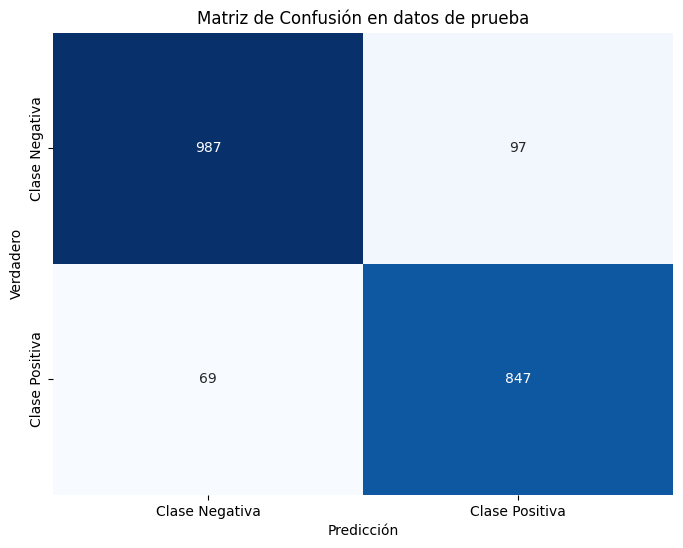

In [ ]:
# Obtener la matriz de confusión para los datos de prueba
conf_matrix_test = confusion_matrix(y_test, y_pred)

# Visualizar la matriz de confusión utilizando seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_test, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=["Clase Negativa", "Clase Positiva"],
            yticklabels=["Clase Negativa", "Clase Positiva"])
plt.title("Matriz de Confusión en datos de prueba")
plt.xlabel("Predicción")
plt.ylabel("Verdadero")
plt.show()

# Interpretabilidad

## LIME

### Gradient Boosting

In [ ]:
lime_explainer = LimeTabularExplainer(X_train_normalized,
                                       feature_names=feature_names,
                                       mode='classification',
                                       class_names=['No Cáncer', 'Cáncer'],
                                       kernel_width=5)

num_predictions = 10
for i in range(num_predictions):
    exp = lime_explainer.explain_instance(X_test_normalized[i],
                                          best_gradient_boosting.predict_proba,
                                          num_features=12)
    exp.show_in_notebook(show_table=True, show_all=False)

print()

### MLP

In [ ]:
def predict_proba(X):
    probas = best_model_mlp.predict(X)
    return np.hstack((1 - probas, probas))

explainer = LimeTabularExplainer(
    training_data=X_train_normalized,
    feature_names=feature_names,
    class_names=['Not Cancer', 'Cancer'],
    mode='classification'
)

for i in range(10):
    exp = explainer.explain_instance(X_test_normalized[i], predict_proba, num_features=12)
    exp.show_in_notebook(show_table=True, show_all=False)

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


## SHAPLEY

### Gradient Boosting

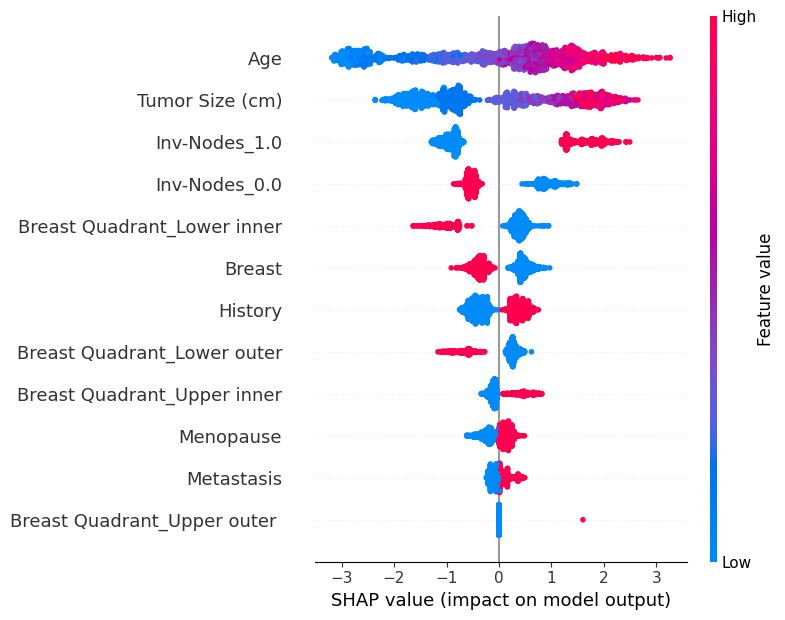

In [ ]:
explainer = shap.Explainer(best_gradient_boosting, X_train_normalized)

shap_values = explainer.shap_values(X_test_normalized)

shap.summary_plot(shap_values, X_test_normalized, feature_names=feature_names)

### MLP

PermutationExplainer explainer: 2001it [02:01, 15.26it/s]


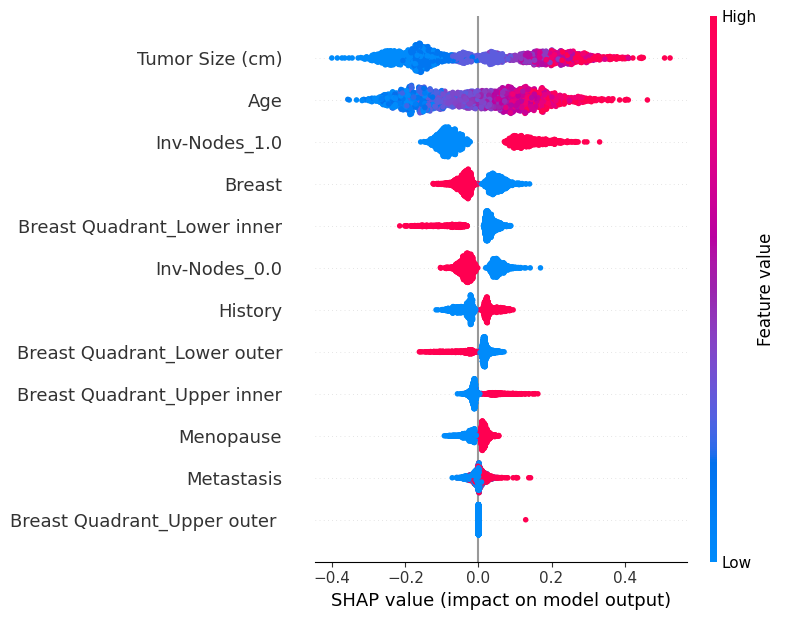

In [ ]:
explainer = shap.Explainer(best_model_mlp, X_train_normalized)

shap_values = explainer.shap_values(X_test_normalized)

shap.summary_plot(shap_values, X_test_normalized, feature_names=feature_names)

# Consenso

In [ ]:
# Definir la función para explicar una instancia con LIME
def explain_instance_with_lime(explainer, instance, predict_proba_fn, feature_names):
    exp = explainer.explain_instance(instance, predict_proba_fn, num_features=len(feature_names), num_samples=500)
    importances = np.zeros(len(feature_names))
    for feature, importance in exp.as_list():
        feature_name = re.split('[<=>]', feature)[0].strip()
        if feature_name in feature_names:
            feature_idx = feature_names.index(feature_name)
            importances[feature_idx] = importance
    return importances

# Instancia de LIME para MLP
lime_explainer_mlp = LimeTabularExplainer(
    training_data=X_train_normalized,
    feature_names=feature_names,
    class_names=['Not Cancer', 'Cancer'],
    mode='classification'
)

# Ejecutar LIME en paralelo para MLP
lime_importances_mlp = Parallel(n_jobs=-1)(delayed(explain_instance_with_lime)(lime_explainer_mlp, X_test_normalized[i], predict_proba, feature_names) for i in range(len(X_test_normalized)))
lime_importances_mlp = np.array(lime_importances_mlp)
lime_global_importances_mlp = np.mean(lime_importances_mlp, axis=0)
print("Importancias globales de LIME para MLP:", lime_global_importances_mlp)

# Instancia de LIME para Gradient Boosting
lime_explainer_gb = LimeTabularExplainer(
    training_data=X_train_normalized,
    feature_names=feature_names,
    class_names=['Not Cancer', 'Cancer'],
    mode='classification'
)

# Ejecutar LIME en paralelo para Gradient Boosting
lime_importances_gb = Parallel(n_jobs=-1)(delayed(explain_instance_with_lime)(lime_explainer_gb, X_test_normalized[i], best_gradient_boosting.predict_proba, feature_names) for i in range(len(X_test_normalized)))
lime_importances_gb = np.array(lime_importances_gb)
lime_global_importances_gb = np.mean(lime_importances_gb, axis=0)
print("Importancias globales de LIME para Gradient Boosting:", lime_global_importances_gb)


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


Importancias globales de LIME para MLP: [-0.01384606 -0.02224088 -0.1100826   0.02086757 -0.03593573 -0.01820634
  0.06931747  0.10284401 -0.08336801  0.          0.03247092 -0.09985458]
Importancias globales de LIME para Gradient Boosting: [-0.01119979 -0.0013524  -0.08753711  0.06316292 -0.03028258 -0.05900096
  0.09019809  0.07897904 -0.03438178  0.          0.00630894 -0.19479331]


In [ ]:
# Calcular las importancias globales de SHAP para Gradient Boosting
explainer_gb = shap.Explainer(best_gradient_boosting, X_train_normalized)
shap_values_gb = explainer_gb(X_test_normalized)
shap_global_importances_gb = np.mean(np.abs(shap_values_gb.values), axis=0)
print("Importancias globales de SHAP para Gradient Boosting:", shap_global_importances_gb)

# Calcular las importancias globales de SHAP para MLP
explainer_mlp = shap.Explainer(best_model_mlp, X_train_normalized)
shap_values_mlp = explainer_mlp(X_test_normalized)
shap_global_importances_mlp = np.mean(np.abs(shap_values_mlp.values), axis=0)
print("Importancias globales de SHAP para MLP:", shap_global_importances_mlp)

# Calcular el consenso de importancias
consensus_importances_gb = (lime_global_importances_gb + shap_global_importances_gb) / 2
consensus_importances_mlp = (lime_global_importances_mlp + shap_global_importances_mlp) / 2

# Crear DataFrames para mostrar los resultados
results_gb = pd.DataFrame({
    'Feature': feature_names,
    'LIME Importance': lime_global_importances_gb,
    'SHAP Importance': shap_global_importances_gb,
    'Consensus Importance': consensus_importances_gb
})

results_mlp = pd.DataFrame({
    'Feature': feature_names,
    'LIME Importance': lime_global_importances_mlp,
    'SHAP Importance': shap_global_importances_mlp,
    'Consensus Importance': consensus_importances_mlp
})

# Mostrar los resultados
display(results_gb)
display(results_mlp)

# Guardar los resultados en archivos CSV
results_gb.to_csv('consensus_importance_gb.csv', index=False)
results_mlp.to_csv('consensus_importance_mlp.csv', index=False)

print("Los resultados han sido guardados en 'consensus_importance_gb.csv' y 'consensus_importance_mlp.csv'.")

Importancias globales de SHAP para Gradient Boosting: [1.29792016e+00 1.67869992e-01 1.21518186e+00 4.38248599e-01
 1.12470702e-01 4.07281306e-01 5.22250118e-01 3.80402938e-01
 1.87709236e-01 8.00137017e-04 6.79013784e-01 1.18135621e+00]


PermutationExplainer explainer: 2001it [08:23,  3.89it/s]

Importancias globales de SHAP para MLP: [1.30653179e-01 2.68834172e-02 1.70917377e-01 5.29422688e-02
 1.26559100e-02 4.62640149e-02 5.32193157e-02 4.36622719e-02
 2.21813010e-02 1.31231529e-04 6.39874383e-02 8.61729544e-02]


,Feature,LIME Importance,SHAP Importance,Consensus Importance
0,Age,-0.011200,1.297920,0.643360
1,Menopause,-0.001352,0.167870,0.083259
2,Tumor Size (cm),-0.087537,1.215182,0.563822
3,Breast,0.063163,0.438249,0.250706
4,Metastasis,-0.030283,0.112471,0.041094
5,History,-0.059001,0.407281,0.174140
6,Breast Quadrant_Lower inner,0.090198,0.522250,0.306224
7,Breast Quadrant_Lower outer,0.078979,0.380403,0.229691
8,Breast Quadrant_Upper inner,-0.034382,0.187709,0.076664
9,Breast Quadrant_Upper outer,0.000000,0.000800,0.000400


,Feature,LIME Importance,SHAP Importance,Consensus Importance
0,Age,-0.013846,0.130653,0.058404
1,Menopause,-0.022241,0.026883,0.002321
2,Tumor Size (cm),-0.110083,0.170917,0.030417
3,Breast,0.020868,0.052942,0.036905
4,Metastasis,-0.035936,0.012656,-0.011640
5,History,-0.018206,0.046264,0.014029
6,Breast Quadrant_Lower inner,0.069317,0.053219,0.061268
7,Breast Quadrant_Lower outer,0.102844,0.043662,0.073253
8,Breast Quadrant_Upper inner,-0.083368,0.022181,-0.030593
9,Breast Quadrant_Upper outer,0.000000,0.000131,0.000066


Los resultados han sido guardados en 'consensus_importance_gb.csv' y 'consensus_importance_mlp.csv'.


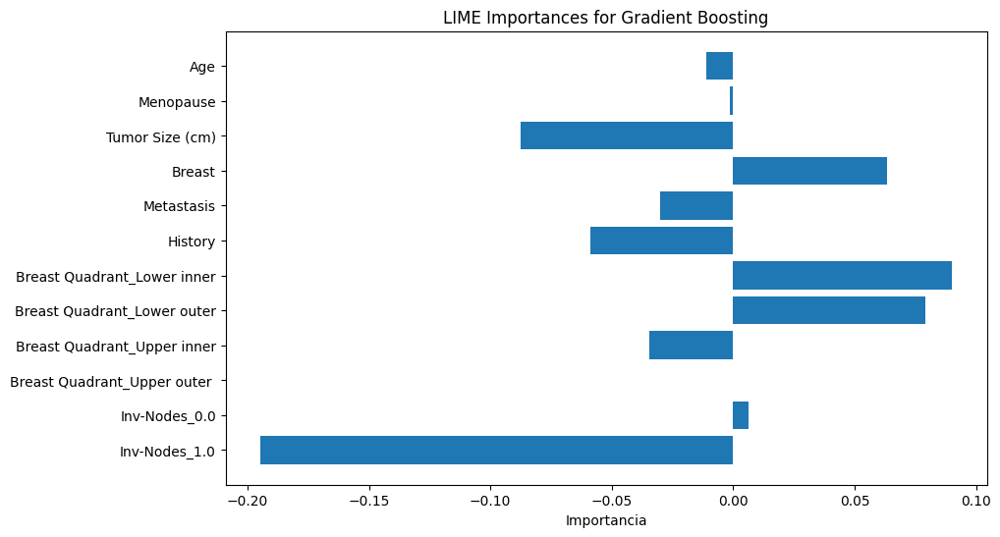

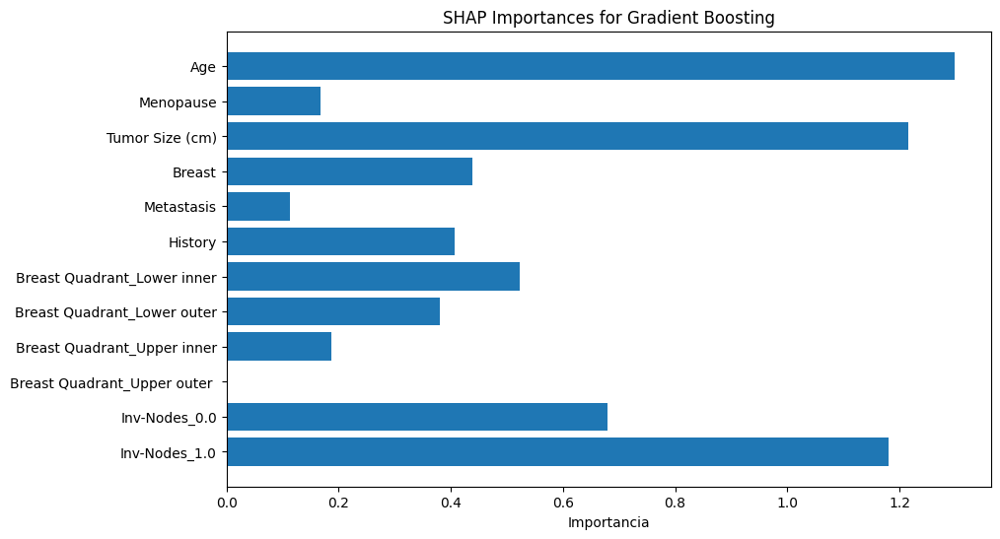

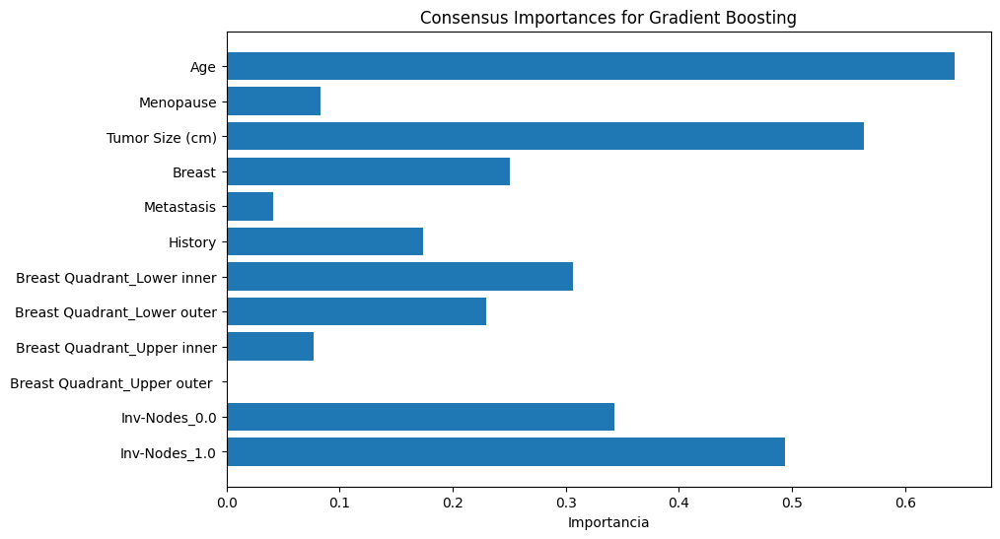

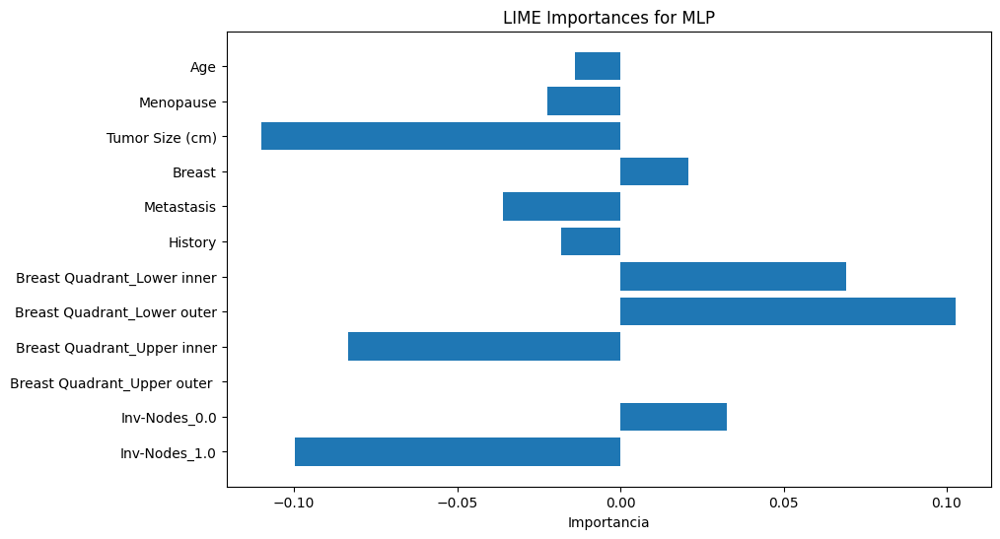

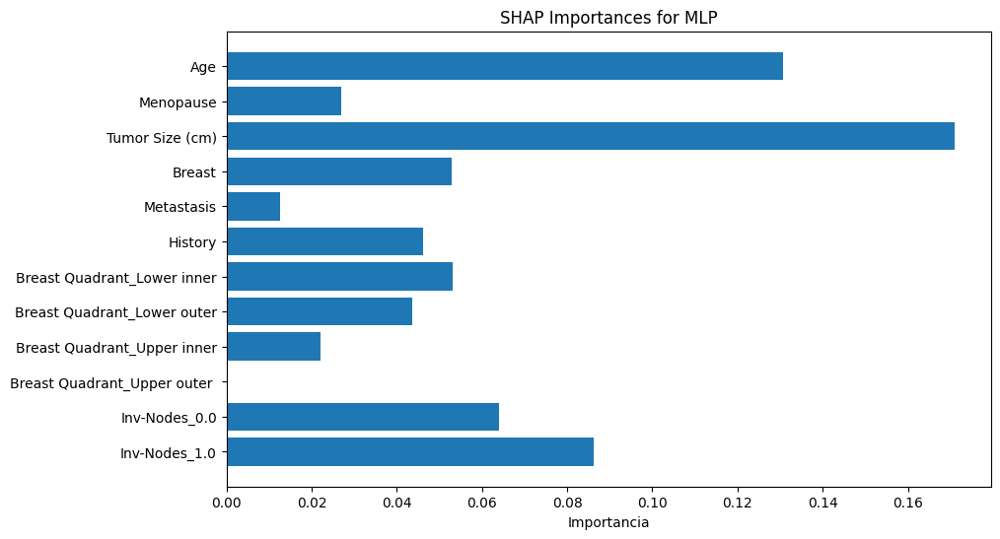

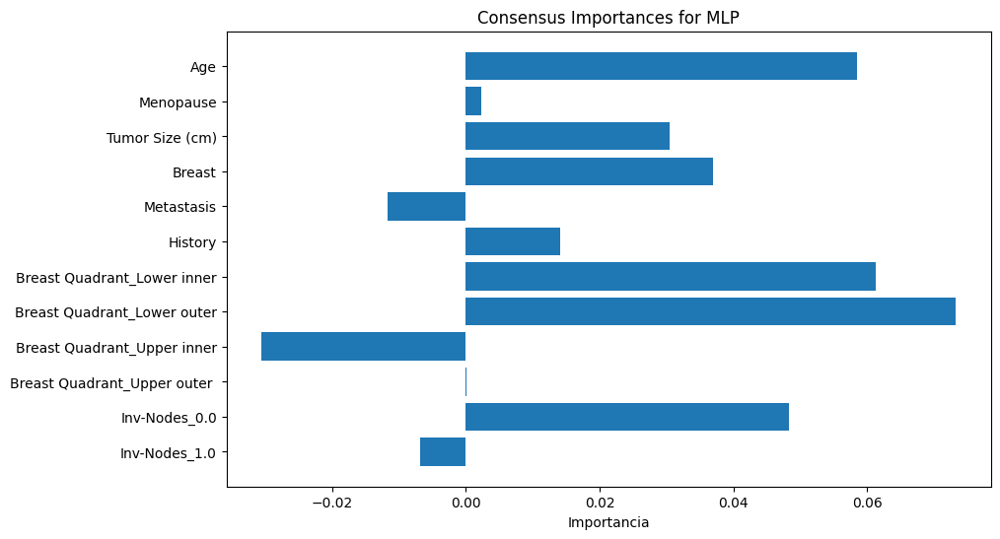

In [ ]:
# Función para visualizar las importancias
def plot_importances(importances, title, feature_names):
    plt.figure(figsize=(10, 6))
    plt.barh(range(len(importances)), importances, align='center')
    plt.yticks(range(len(importances)), feature_names)
    plt.xlabel('Importancia')
    plt.title(title)
    plt.gca().invert_yaxis()
    plt.show()

# Visualizar las importancias de LIME, SHAP y Consenso para Gradient Boosting
plot_importances(lime_global_importances_gb, 'LIME Importances for Gradient Boosting', feature_names)
plot_importances(shap_global_importances_gb, 'SHAP Importances for Gradient Boosting', feature_names)
plot_importances(consensus_importances_gb, 'Consensus Importances for Gradient Boosting', feature_names)

# Visualizar las importancias de LIME, SHAP y Consenso para MLP
plot_importances(lime_global_importances_mlp, 'LIME Importances for MLP', feature_names)
plot_importances(shap_global_importances_mlp, 'SHAP Importances for MLP', feature_names)
plot_importances(consensus_importances_mlp, 'Consensus Importances for MLP', feature_names)

                         Feature  Consensus Importance_GB  \
0                            Age                 0.643360   
1                      Menopause                 0.083259   
2                Tumor Size (cm)                 0.563822   
3                         Breast                 0.250706   
4                     Metastasis                 0.041094   
5                        History                 0.174140   
6    Breast Quadrant_Lower inner                 0.306224   
7    Breast Quadrant_Lower outer                 0.229691   
8    Breast Quadrant_Upper inner                 0.076664   
9   Breast Quadrant_Upper outer                  0.000400   
10                 Inv-Nodes_0.0                 0.342661   
11                 Inv-Nodes_1.0                 0.493281   

    Consensus Importance_MLP  Consensus Importance Global  
0                   0.058404                     0.350882  
1                   0.002321                     0.042790  
2                   0.0304

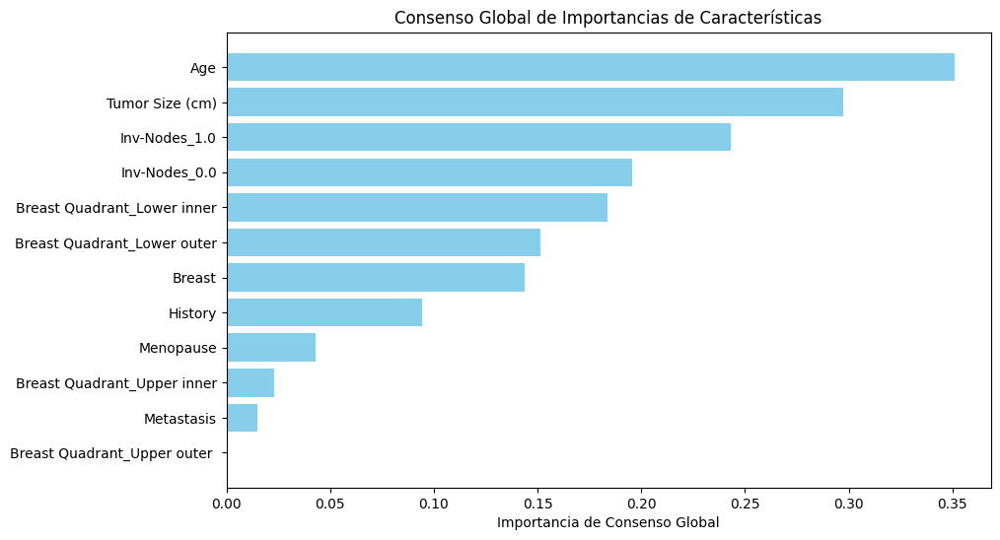

In [ ]:
results_gb = pd.DataFrame({
    'Feature': feature_names,
    'LIME Importance': lime_global_importances_gb,
    'SHAP Importance': shap_global_importances_gb,
    'Consensus Importance': consensus_importances_gb
})

results_mlp = pd.DataFrame({
    'Feature': feature_names,
    'LIME Importance': lime_global_importances_mlp,
    'SHAP Importance': shap_global_importances_mlp,
    'Consensus Importance': consensus_importances_mlp
})

# Combinar los DataFrames en uno solo
df_combined = pd.merge(results_gb[['Feature', 'Consensus Importance']],
                       results_mlp[['Feature', 'Consensus Importance']],
                       on='Feature',
                       suffixes=('_GB', '_MLP'))

# Calcular el consenso global
df_combined['Consensus Importance Global'] = (df_combined['Consensus Importance_GB'] + df_combined['Consensus Importance_MLP']) / 2

# Mostrar el DataFrame resultante
print(df_combined)

# Ordenar por importancia de consenso global
df_combined = df_combined.sort_values(by='Consensus Importance Global', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(df_combined['Feature'], df_combined['Consensus Importance Global'], color='skyblue')
plt.xlabel('Importancia de Consenso Global')
plt.title('Consenso Global de Importancias de Características')
plt.gca().invert_yaxis()  # Invertir el eje y para mostrar las características más importantes en la parte superior
plt.show()